In [1]:
from scipy.spatial import distance

In [2]:
from imutils import face_utils

In [3]:
import numpy as np

In [19]:
  from google.colab.patches import cv2_imshow


In [4]:
import time

In [5]:
import dlib

In [6]:
import cv2

In [7]:
EYE_ASPECT_RATIO_THRESHOLD =  0.3

In [8]:
EYE_ASPECT_RATIO_CONSEC_FRAMES = 50

In [9]:
COUNTER = 0

In [10]:
face_cascade = cv2.CascadeClassifier('/content/haarcascade_frontalface_default.xml')

In [15]:
def eye_aspect_ratio(eye):
  A=distance.euclidean(eye[1], eye[5])
  B=distance.euclidean(eye[2], eye[4])
  C=distance.euclidean(eye[0], eye[3])
  ear = (A+B)/(2*C)
  return ear

In [23]:
detector = dlib.get_frontal_face_detector()

In [20]:
predictor= dlib.shape_predictor('/content/shape_predictor_68_face_landmarks.dat')

In [13]:
(lStart, lEnd) = face_utils.FACIAL_LANDMARKS_IDXS['left_eye']

In [14]:
(rStart, rEnd) = face_utils.FACIAL_LANDMARKS_IDXS['right_eye']

In [16]:
video_file_path = '/content/drowsiness_video.mp4'

In [17]:
video_capture = cv2.VideoCapture(video_file_path)

In [ ]:
video_capture = cv2.VideoCa

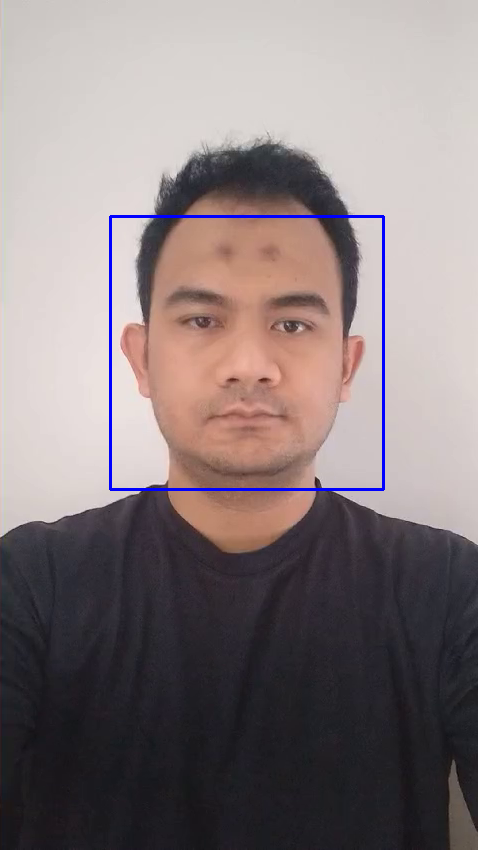

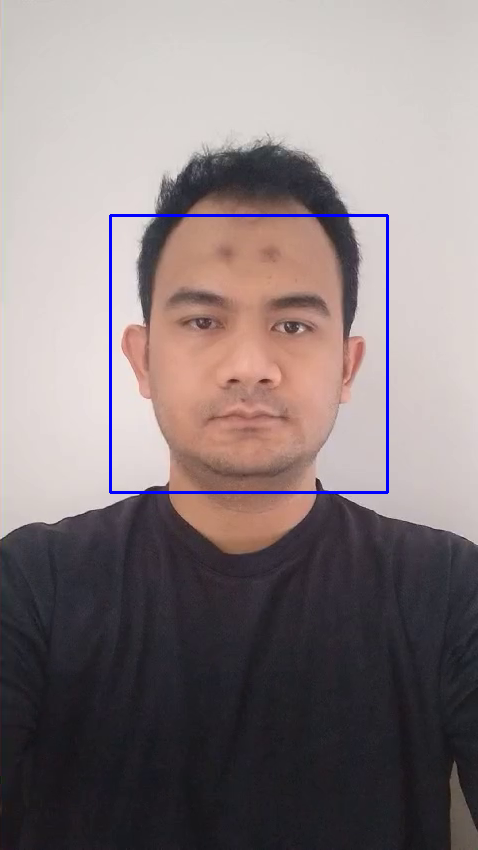

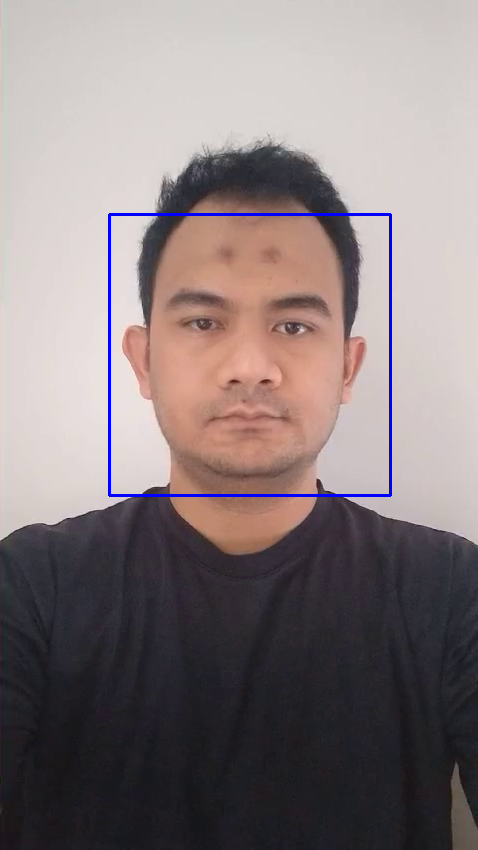

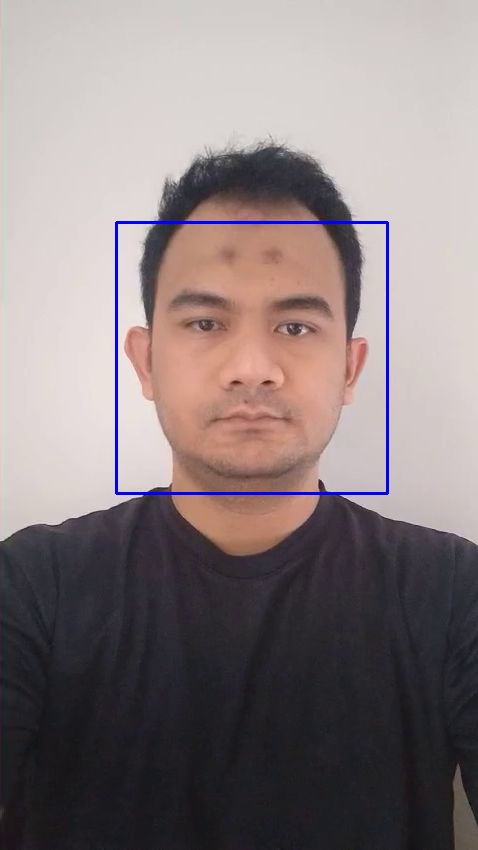

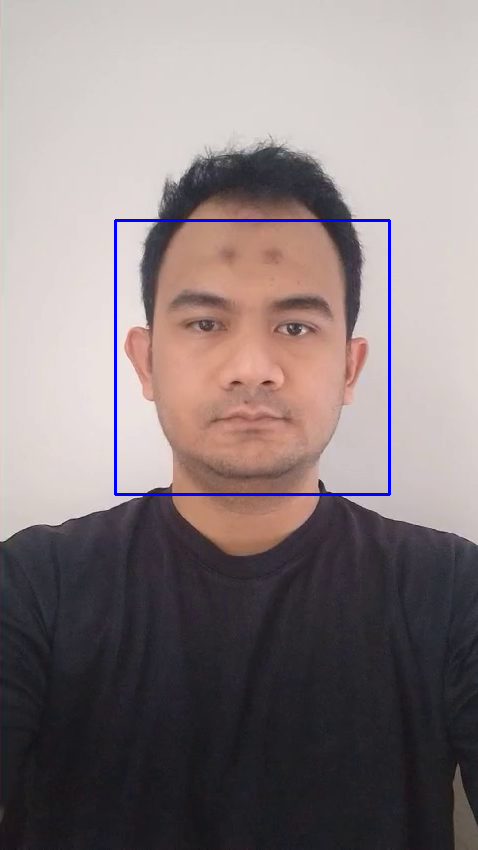

...

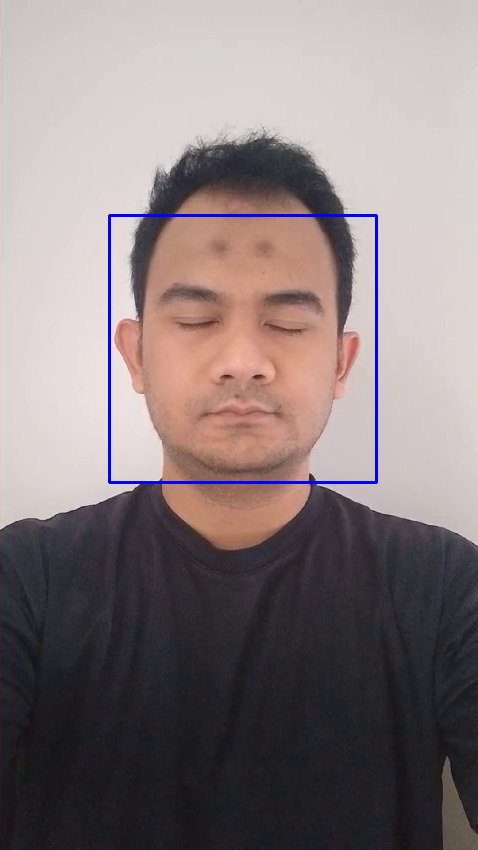

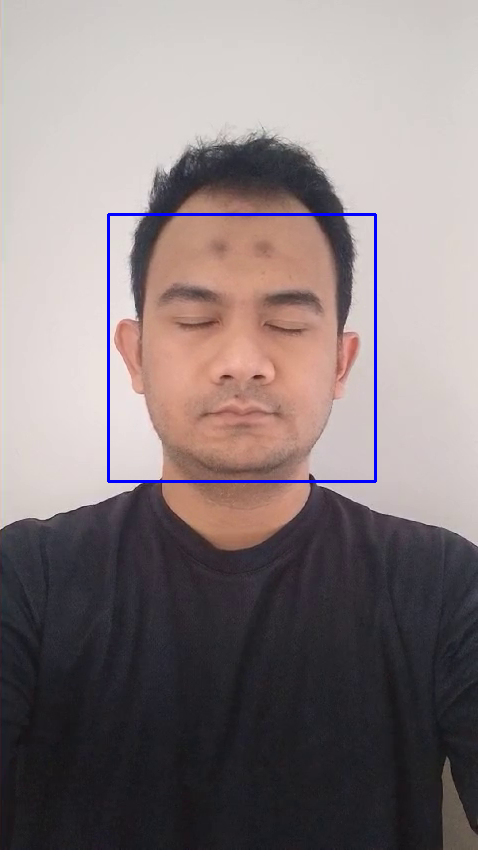

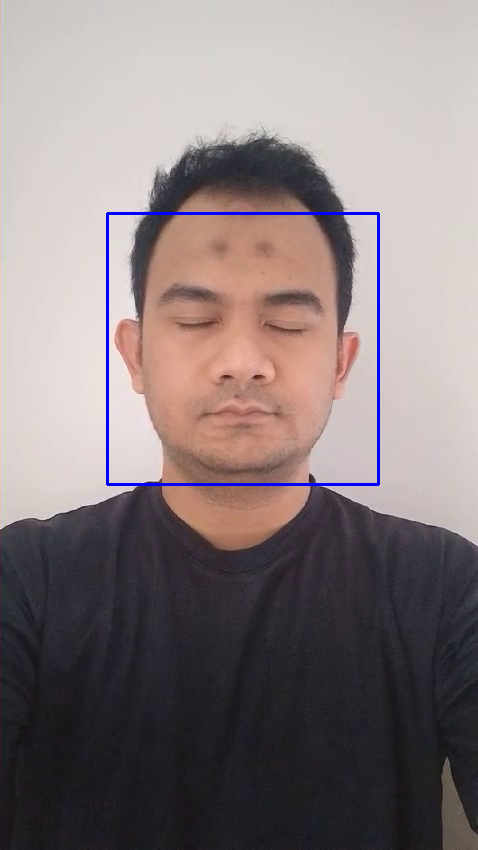

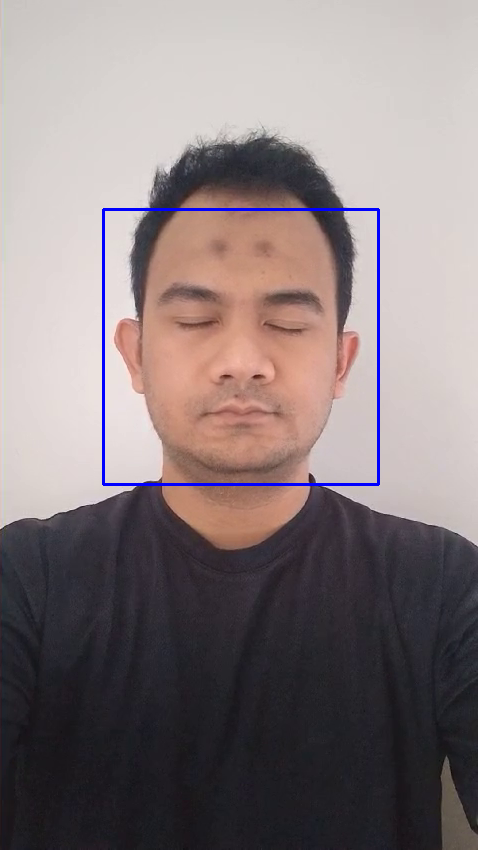

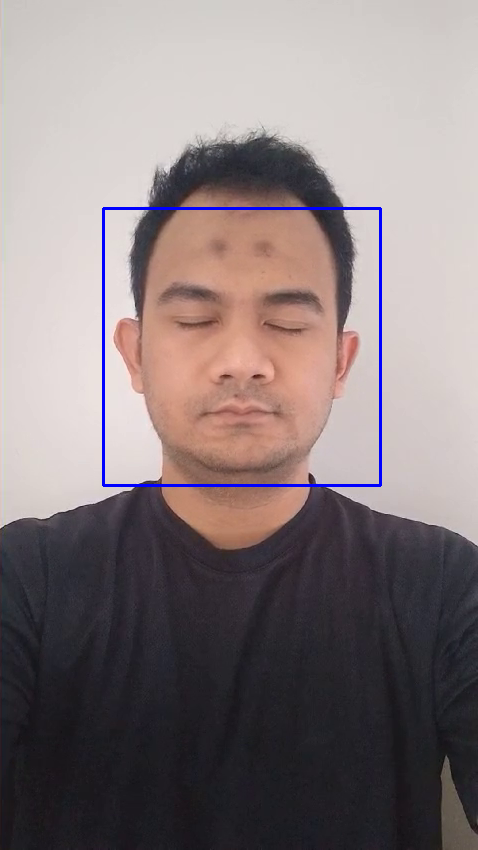

KeyboardInterrupt: 

In [24]:
while video_capture.isOpened():
  ret, frame = video_capture.read()
  if not ret:
    break
  frame = cv2.flip(frame,1)
  gray = cv2.cvtColor(frame,cv2.COLOR_BGR2GRAY)
  faces = detector(gray,0)
  face_rectangle=face_cascade.detectMultiScale(gray, 1.3,5)

  for (x,y,w,h) in face_rectangle:
    cv2.rectangle(frame, (x,y), (x+w,y+h), (255,0,0), 2)

  for face in faces:

    shape = predictor(gray, face)
    shape = face_utils.shape_to_np(shape)

    leftEye = shape[lStart:lEnd]
    rightEye = shape[rStart:rEnd]

    leftEyeAspectRatio = eye_aspect_ratio(leftEye)
    rightEyeAspectRatio = eye_aspect_ratio(rightEye)

    eyeAspectRatio = (leftEyeAspectRatio + rightEyeAspectRatio) /2

    leftEyeHull = cv2.convexHull(leftEye)
    rightEyeHull = cv2.convexHull(rightEye)
    cv2.drawContours(frame, [leftEyeHull], -1, (0,255,0), 1)
    cv2.drawContours(frame, [rightEyeHull], -1, (0,255,0), 1)

    if eyeAspectRatio < EYE_ASPECT_RATIO_THRESHOLD:
      COUNTER += 1
      if COUNTER >= EYE_ASPECT_RATIO_CONSEC_FRAMES:
        cv2.putText(frame, "ngantuk", (150,200), cv2.FONT_HERSHEY_SIMPLEX, 1.5, (0,0,255), 2)
      else:
        COUNTER = 0

  cv2_imshow(frame)
  if cv2.waitKey(1) & 0xFF == ord('q'):
    break

video_capture.release()
cv2.destroyAllWindoes()


